# Assignment 3

In [ ]:
# Import libraries
import numpy as np
import pandas as pd
from sklearn.datasets import make_classification
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split

## Task 1: MLE computation

As you know, we can think about linear regression from the optimization point of view (as the problem of minimizing the root mean squared error), but we can also consider it from the probabilistic point of view.
Let's consider the following equation:

\begin{equation*}
y_i=x_i B_0+\varepsilon_i
\end{equation*}

where $y_i$ is the dependent variable, $x_i$ is a $1 \times K$ vector of regressors, $\beta_0$ is the $K \times 1$ vector of regression coefficients to be estimated and $\varepsilon_i$ is an unobservable error term.

The sample is made up of $N$ IID observations $\left(y_i, x_i\right)$.
The regression equations can be also written as

\begin{equation*}
y=X \beta_0+\varepsilon
\end{equation*}

where the $N \times 1$ vector of observations of the dependent variable is denoted by $y$, the $N \times K$ matrix of regressors is denoted by $X$, and the $N \times 1$ vector of error terms is denoted by $\varepsilon$.

As everybody interested in probability theory knows, we always have to have some assumptions. In this case, we assume that the vector of errors $\varepsilon$ has a multivariate normal distribution conditional on $x$, with mean equal to 0 and covariance matrix equal to

\begin{equation*}
\sigma_0^2 I
\end{equation*}

where $l$ is the $N \times N$ identity matrix and

\begin{equation*}
\sigma_0^2=\operatorname{Var}\left[\varepsilon_i \mid X\right]
\end{equation*}

is the second parameter to be estimated.
Furthermore, it is assumed that the matrix of regressors $x$ has full-rank.

Those assumptions have interesting implications:
- the covariance matrix of $\varepsilon$ is diagonal implies that the entries of $\varepsilon$ are mutually independent (i.e., $\varepsilon_i$ is independent of $\varepsilon_j$ for $i \neq j$.)
- they all have a normal distribution with mean 0 and variance $\sigma_0^2$.

The fact that we transform normal random variables linearly makes the dependent variable $y_i$ conditionally normal, with mean $x_i \beta_0$ and variance $\sigma_0^2$. Therefore, its cdf is

\begin{equation*}
f_Y\left(y_i \mid X\right)=\left(2 \pi \sigma_0^2\right)^{-1 / 2} \exp \left(-\frac{1}{2} \frac{\left(y_i-x_i \beta_0\right)^2}{\sigma_0^2}\right)
\end{equation*}

Having this probability model we can use it to do estimation of regression parameters using Maximum Likelihood Estimation method.

The first-order conditions for a maximum are

\begin{equation*}
\begin{aligned}
& \nabla_\beta l\left(\beta, \sigma^2 ; y, X\right)=0 \\
& \frac{\partial}{\partial \sigma^2} l\left(\beta, \sigma^2 ; y, X\right)=0
\end{aligned}
\end{equation*}

where $\nabla_\beta$ indicates the gradient calculated with respect to $\beta$, that is, the vector of the partial derivatives of the log-likelihood with respect to the entries of $\beta$. The gradient is

\begin{equation*}
\begin{aligned}
& \nabla_\beta l\left(\beta, \sigma^2: y, X\right) \\
= & \nabla_\beta\left(-\frac{N}{2} \ln (2 \pi)-\frac{N}{2} \ln \left(\sigma^2\right)-\frac{1}{2 \sigma^2} \sum_{i=1}^N\left(y_i-x_i \beta\right)^2\right) \\
= & \frac{1}{\sigma^2} \sum_{i=1}^N x_i^{\top}\left(y_i-x_i \beta\right) \\
= & \frac{1}{\sigma^2}\left(\sum_{i=1}^N x_i^{\top} y_i-\sum_{i=1}^N x_i^{\top} x_i \beta\right)
\end{aligned}
\end{equation*}

which is equal to zero only if

\begin{equation*}
\sum_{i=1}^N x_i^{\top} y_i-\sum_{i=1}^N x_i^{\top} x_i \beta=0
\end{equation*}


Therefore, the first of the two equations is satisfied if

\begin{equation*}
\beta=\left(\sum_{i=1}^N x_i^{\top} x_i\right)^{-1} \sum_{i=1}^N x_i^{\top} y_i=\left(X^{\top} X\right)^{-1} X^{\top} y
\end{equation*}

where we have used the assumption that $x$ has full rank and, as a consequence, $x^x x$ is invertible.


### Subtask A:
Prove that the MLE for variance is equal to
$$
\widehat{\sigma}_n^2=\frac{1}{N} \sum_{i=1}^N\left(y_i-x_i \widehat{\beta}_N\right)^2
$$

### MLE for Logistic regression

In the logistic regression model, the output variable $y_i$ is a Bernoulli random variable (it can take only two values, either 1 or 0 ) and

\begin{equation*}
\mathrm{P}\left(y_i=1 \mid x_i\right)=S\left(x_i \beta\right)
\end{equation*}

where

\begin{equation*}
S(t)=\frac{1}{1+\exp (-t)}
\end{equation*}

is the logistic function, $x_i$ is a $1 \times K$ vector of inputs and $\beta$ is a $K \times 1$ vector of coefficients.

Furthermore,

\begin{equation*}
\mathrm{P}\left(y_i=0 \mid x_i\right)=1-S\left(x_i \beta\right)
\end{equation*}


The vector of coefficients $\beta$ is the parameter to be estimated by maximum likelihood.
We assume that the estimation is carried out with an IID sample comprising $N$ data points

\begin{equation*}
\left(y_i, x_i\right) \text { for } i=1, \ldots, N
\end{equation*}

### Subtask B
1. Find the form of the loglikelihood.
2. Compute the gradient of logistic function with respect to $\beta$

You can either tex your solution and put it in this notebook or attach photos of your solution.

Subtask A


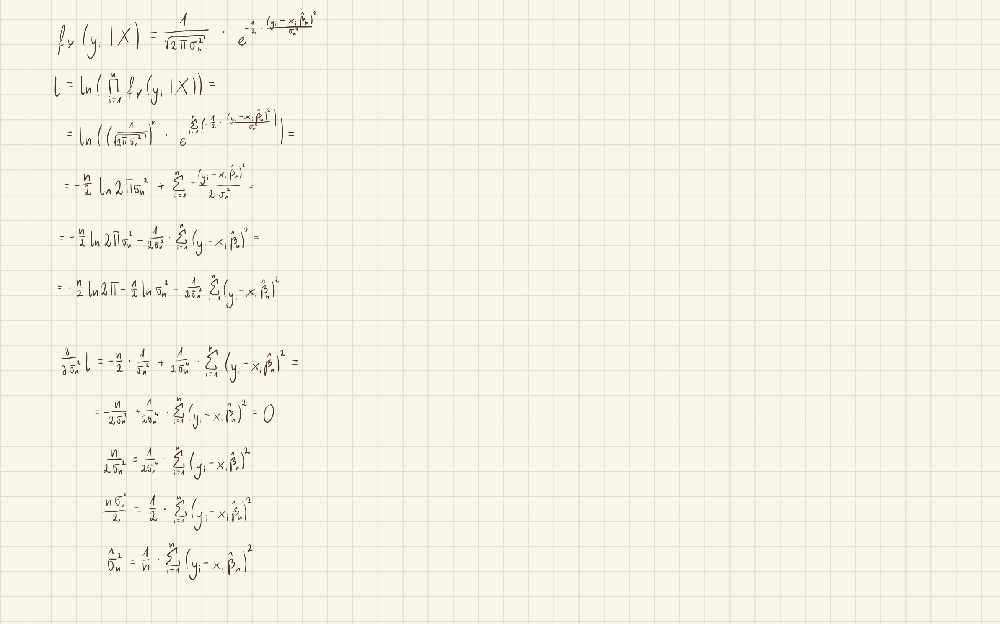

Subtask B

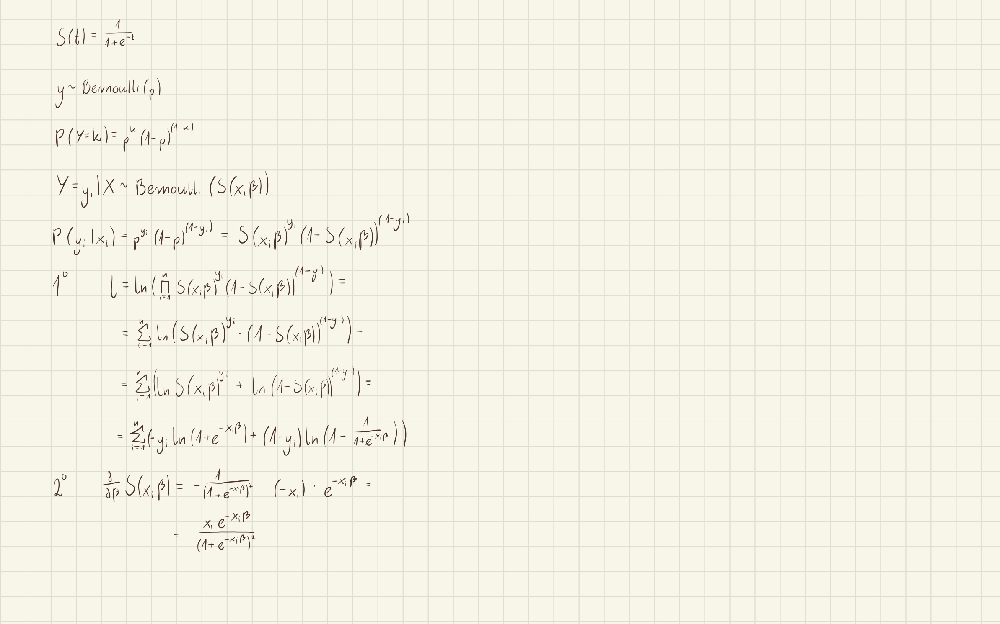

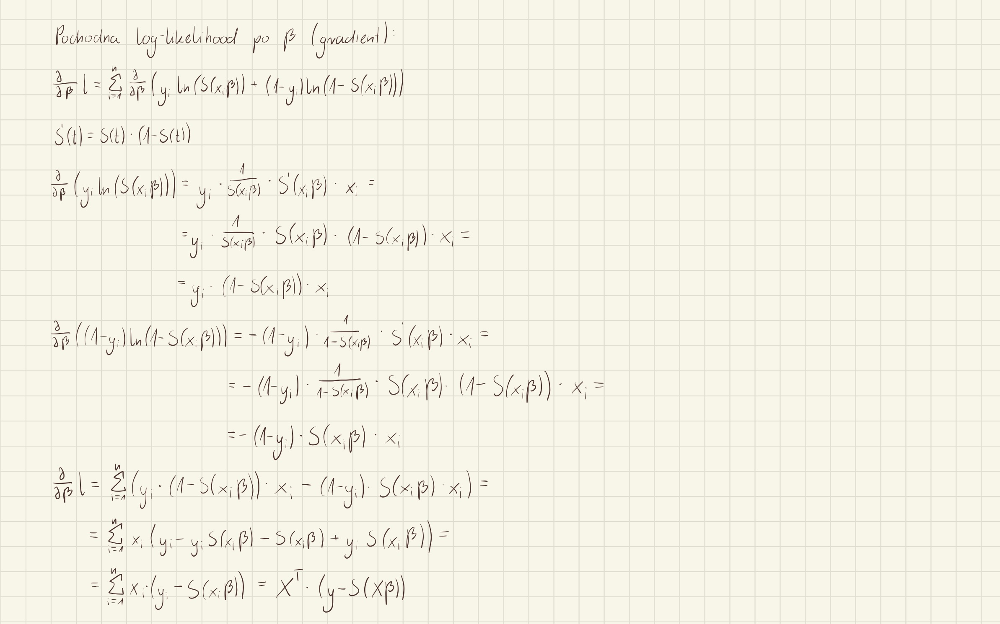

## Task 2: Implement Logistic Regression

Use derivations form previous task to perform logistic regression. Provide a custom implemntation of gradient descent for this taks.
**Bonus points** provide also implementation of other optimization algorithm of your choice, eg. Newton-Rhapson method.


Without bias

In [ ]:
import numpy as np

#Sigmoid function
def S(t):
    return 1 / (1 + np.exp(-t))

#Average cost function
def loglikehood(X, y, beta):
    #Adding 1e-15 prevents numerical issues with log(0)
    return -np.mean(y * np.log(S(X @ beta) + 1e-15) + (1 - y) * np.log(1 - S(X @ beta) + 1e-15))

def gradient_descent(X, y, learning_rate, epochs):
    n = X.shape[0] #Number of samples
    beta = np.zeros(X.shape[1])  #Initialize coefficients (vector of zeros with the number of features)
    cost_history = np.zeros(epochs)

    for epoch in range(epochs):
        #Compute hypothesis
        t = X @ beta
        y_pred = S(t)

        #Compute cost function
        cost = loglikehood(X, y, beta)
        cost_history[epoch] = cost

        #Compute gradient of the cost function
        dbeta = (1 / n) * X.T @ (y_pred - y)

        #Update parameters using gradient descent rule
        beta = beta - learning_rate * dbeta

        if epoch % 100 == 0:
            print(f"Epoch {epoch}: Cost {cost}")

    return beta, cost_history

def logistic_regression(X, y, learning_rate, epochs):
    beta, cost_history = gradient_descent(X, y, learning_rate, epochs)
    return beta, cost_history

Usage example:

Epoch 0: Cost 0.6931471805599436
Epoch 100: Cost 0.28451997732877743
Epoch 200: Cost 0.21278112486671333
Epoch 300: Cost 0.17920039510276242
Epoch 400: Cost 0.15865405361236654
Epoch 500: Cost 0.14438988501576033
Epoch 600: Cost 0.13372746167176117
Epoch 700: Cost 0.125360203937364
Epoch 800: Cost 0.1185637016570136
Epoch 900: Cost 0.11289901960977725
Estimated coefficients (beta): [ 4.51193047 -3.09571091]
Final cost: 0.10812695902742953


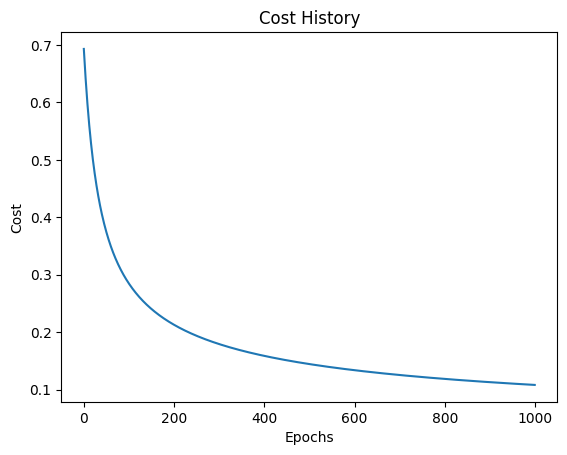

In [ ]:
#Generating test data
np.random.seed(42)
n_samples = 100
n_features = 2

#Creating feature matrix X and label vector y
X = np.random.randn(n_samples, n_features)  #Random input data
true_beta = np.array([0.5, -0.3])  #True coefficients used for data generation
y = (S(X @ true_beta) > 0.5).astype(int)  #Generating binary labels 0/1 based on sigmoid

learning_rate = 0.1
epochs = 1000

beta, cost_history = logistic_regression(X, y, learning_rate, epochs)

print("Estimated coefficients (beta):", beta)
print("Final cost:", cost_history[-1])

# Wizualizacja funkcji kosztu
import matplotlib.pyplot as plt

plt.plot(range(epochs), cost_history)
plt.xlabel("Epochs")
plt.ylabel("Cost")
plt.title("Cost History")
plt.show()

With bias

In [ ]:
import numpy as np

def S(t):
    return 1 / (1 + np.exp(-t))

def loglikehood(X, y, beta):
    return -np.mean(y * np.log(S(X @ beta) + 1e-15) + (1 - y) * np.log(1 - S(X @ beta) + 1e-15))

def gradient_descent(X, y, learning_rate, epochs):
    n = X.shape[0]
    beta = np.zeros(X.shape[1])
    cost_history = np.zeros(epochs)

    for epoch in range(epochs):
        t = X @ beta
        y_pred = S(t)

        cost = loglikehood(X, y, beta)
        cost_history[epoch] = cost

        dbeta = (1 / n) * X.T @ (y_pred - y)

        beta = beta - learning_rate * dbeta

        if epoch % 100 == 0:
            print(f"Epoch {epoch}: Cost {cost}")

    return beta, cost_history

def logistic_regression(X, y, learning_rate, epochs):
    #Adding a bias term as a column of ones to the feature matrix X
    X = np.c_[np.ones(X.shape[0]), X]
    beta, cost_history = gradient_descent(X, y, learning_rate, epochs)
    return beta, cost_history

Przykład użycia:

Epoch 0: Cost 0.6931471805599436
Epoch 100: Cost 0.2779548222006363
Epoch 200: Cost 0.21787638420022226
Epoch 300: Cost 0.1906654599968088
Epoch 400: Cost 0.1743821325486891
Epoch 500: Cost 0.16326790333368443
Epoch 600: Cost 0.1550649836353336
Epoch 700: Cost 0.14868471119488746
Epoch 800: Cost 0.14353021307156036
Epoch 900: Cost 0.13924407270798528
Estimated coefficients (beta): [ 0.31714578 -1.21778511  0.94153278]
Final cost: 0.1356318210746958


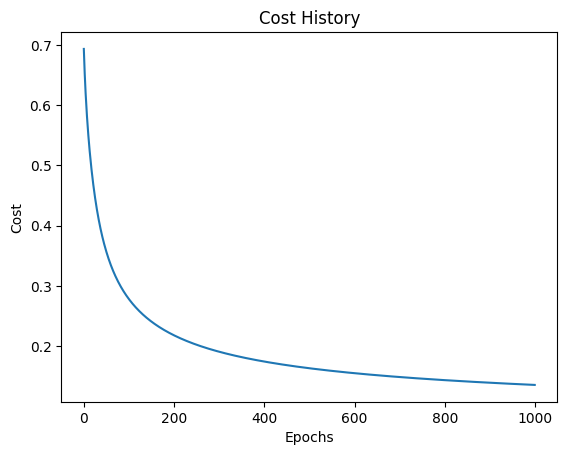

In [ ]:
np.random.seed(42)
n_samples = 100
n_features = 2
X = np.random.rand(n_samples, n_features) * 10
true_beta = np.array([2, -1, 0.5]) #True coefficients used for data generation (with bias)
y = (S(np.c_[np.ones(n_samples), X] @ true_beta) > 0.5).astype(int)

learning_rate = 0.01
epochs = 1000

beta, cost_history = logistic_regression(X, y, learning_rate, epochs)

print("Estimated coefficients (beta):", beta)
print("Final cost:", cost_history[-1])

import matplotlib.pyplot as plt

plt.plot(range(epochs), cost_history)
plt.xlabel("Epochs")
plt.ylabel("Cost")
plt.title("Cost History")
plt.show()

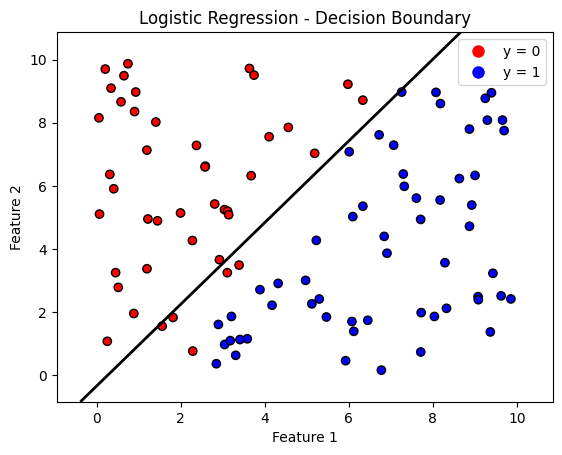

In [ ]:
def plot_decision_boundary(X, y, beta):
    import matplotlib.pyplot as plt

    # Define axis ranges
    x_min, x_max = X[:, 0].min() - 1, X[:, 0].max() + 1
    y_min, y_max = X[:, 1].min() - 1, X[:, 1].max() + 1

    # Create a grid of points
    xx, yy = np.meshgrid(np.linspace(x_min, x_max, 100),
                         np.linspace(y_min, y_max, 100))
    grid = np.c_[xx.ravel(), yy.ravel()]
    grid_with_bias = np.c_[np.ones(grid.shape[0]), grid]  # Add bias term to the grid

    # Compute predictions for the grid
    probs = S(grid_with_bias @ beta).reshape(xx.shape)

    # Plot the decision boundary (where probability is 0.5)
    plt.contour(xx, yy, probs, levels=[0.5], colors='black', linewidths=2)

    # Plot data points
    scatter = plt.scatter(X[:, 0], X[:, 1], c=y, cmap='bwr', edgecolors='k')

    # Add legend for classes
    red_patch = plt.Line2D([0], [0], marker='o', color='w', markerfacecolor='red', markersize=10, label='y = 0')
    blue_patch = plt.Line2D([0], [0], marker='o', color='w', markerfacecolor='blue', markersize=10, label='y = 1')
    plt.legend(handles=[red_patch, blue_patch], loc='upper right')

    # Add labels and title
    plt.xlabel("Feature 1")
    plt.ylabel("Feature 2")
    plt.title("Logistic Regression - Decision Boundary")

    # Show the plot
    plt.show()

# Visualize the decision boundary
plot_decision_boundary(X, y, beta)

## Task 3: Classification for Imbalanced Data

Split the data using a technique suitable for imbalanced classes. Describe its working.

Train a logistic regression model on the below data.

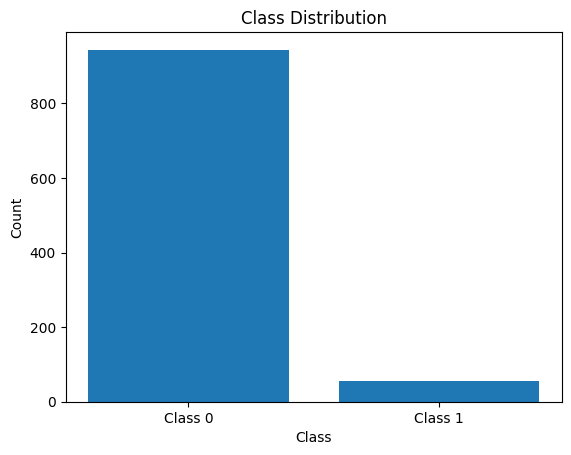

Dataset Shape: (1000, 20)
Class Distribution: [944  56]


In [ ]:
import numpy as np
from sklearn.datasets import make_classification
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import classification_report, roc_auc_score
import matplotlib.pyplot as plt


# Create a synthetic dataset
X, y = make_classification(
    n_samples=1000,
    n_informative=4, n_redundant=5, n_features=20, n_clusters_per_class=3,
    n_classes=2,
    weights=[0.95, 0.05],
    random_state=42
)

# Visualize class distribution
def visualize_class_distribution(y):
    plt.bar(['Class 0', 'Class 1'], [sum(y == 0), sum(y == 1)])
    plt.title("Class Distribution")
    plt.xlabel("Class")
    plt.ylabel("Count")
    plt.show()

visualize_class_distribution(y)

# Summarize dataset
print("Dataset Shape:", X.shape)
print("Class Distribution:", np.bincount(y))


In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, stratify=y, random_state=42)

stratify=y ensures that the proportion of each class in the target variable
y is preserved in both the training and test sets. It first calculates the class distribution in y, then splits each class separately into training and test sets, maintaining the same proportions. Afterward, it combines these splits to form the final sets. This ensures that both sets have the same class distribution as in the original data, which is especially important for imbalanced datasets.

In [ ]:
# Class proportions in the original dataset
original_class_ratios = np.bincount(y) / len(y)

print("Class distribution in the original dataset:", np.bincount(y))
print("Class proportions in the original dataset:", original_class_ratios)

from collections import Counter
import numpy as np

# Number of samples and proportions in the training set
print("Class distribution in the training set:", np.bincount(y_train))
#print("Class distribution in the training set (Counter):", Counter(y_train))
train_class_ratios = np.bincount(y_train) / len(y_train)
print("Class proportions in the training set:", train_class_ratios)

# Number of samples and proportions in the test set
print("Class distribution in the test set:", np.bincount(y_test))
#print("Class distribution in the test set (Counter):", Counter(y_test))
test_class_ratios = np.bincount(y_test) / len(y_test)
print("Class proportions in the test set:", test_class_ratios)

Class distribution in the original dataset: [944  56]
Class proportions in the original dataset: [0.944 0.056]
Class distribution in the training set: [755  45]
Class proportions in the training set: [0.94375 0.05625]
Class distribution in the test set: [189  11]
Class proportions in the test set: [0.945 0.055]


In [ ]:
#Training the logistic regression model
model = LogisticRegression(solver='liblinear', random_state=42)
model.fit(X_train, y_train)

#Making predictions on the test set
y_pred = model.predict(X_test)

In [ ]:
predicted_class_ratios = np.bincount(y_pred) / len(y_pred)
print("Class proportions in predicted data:", predicted_class_ratios)

Class proportions in predicted data: [0.975 0.025]


Evaluate your binary classifiers using the following:
- confusion matrix,
- accuracy,
- precision,
- recall,
- F1 score,
- ROCAUC.

Please write custom functions calculating the above functions and plotting the receiver operating characteristic curve. Describe your intuition behind each metric and its suitability for imbalanced classes.



Custom Confusion Matrix:
True Positives: 5
True Negatives: 189
False Positives: 0
False Negatives: 6
Custom Accuracy: 0.9700
Custom Precision: 1.0000
Custom Recall: 0.4545
Custom F1-Score: 0.6250


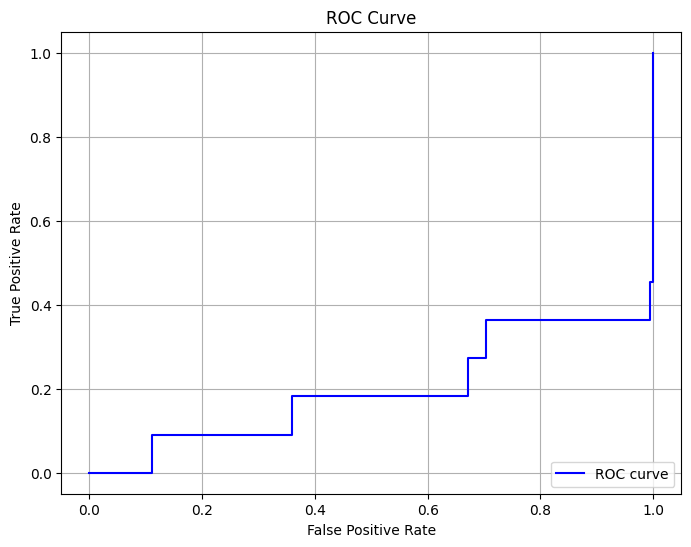

Custom ROC AUC score: 30.80423280423291


In [ ]:
#Custom confusion matrix function

#Intuition: The confusion matrix is a fundamental tool for understanding the performance of a classifier.
#It counts the number of correct and incorrect predictions, including true positives (TP), true negatives (TN),
#false positives (FP), and false negatives (FN). It's essential to understand how the model behaves for each class,
#especially when classes are imbalanced. For imbalanced classes, focusing on the number of false positives and false negatives
#becomes critical, as the accuracy may not reflect the true performance of the classifier.

def custom_confusion_matrix(y_true, y_pred):
    true_positive = np.sum((y_true == 1) & (y_pred == 1))  #True positives: predicted 1, actual 1
    true_negative = np.sum((y_true == 0) & (y_pred == 0))  #True negatives: predicted 0, actual 0
    false_positive = np.sum((y_true == 0) & (y_pred == 1)) #False positives: predicted 1, actual 0
    false_negative = np.sum((y_true == 1) & (y_pred == 0)) #False negatives: predicted 0, actual 1
    return true_positive, true_negative, false_positive, false_negative

#Custom accuracy function

#Intuition: Accuracy is the proportion of correct predictions (TP + TN) to total samples.
#However, accuracy can be misleading when dealing with imbalanced datasets. If one class significantly outnumbers the other,
#a model that predicts the majority class most of the time can still appear to perform well, despite being poor at predicting the minority class.

def custom_accuracy(y_true, y_pred):
    true_positive, true_negative, false_positive, false_negative = custom_confusion_matrix(y_true, y_pred)
    return (true_positive + true_negative) / len(y_true)  #Accuracy = (TP + TN) / total samples

#Custom precision function

#Intuition: Precision measures the proportion of true positives out of all predicted positives.
#It is particularly useful when the cost of false positives is high, such as in medical diagnoses or fraud detection.
#Precision is a better metric than accuracy when dealing with imbalanced classes, as it focuses on the performance of the classifier for the minority class.

def custom_precision(y_true, y_pred):
    true_positive, true_negative, false_positive, false_negative = custom_confusion_matrix(y_true, y_pred)
    return true_positive / (true_positive + false_positive)  #Precision = TP / (TP + FP)

#Custom recall function

#Intuition: Recall, also known as sensitivity, measures the proportion of true positives out of all actual positives.
#It is especially useful when the cost of false negatives is high, such as in identifying rare diseases.
#Like precision, recall is more informative than accuracy when working with imbalanced classes, as it highlights how well the model detects the minority class.

def custom_recall(y_true, y_pred):
    true_positive, true_negative, false_positive, false_negative = custom_confusion_matrix(y_true, y_pred)
    return true_positive / (true_positive + false_negative)  #Recall = TP / (TP + FN)

#Custom F1-score function

#Intuition: The F1-score is the harmonic mean of precision and recall. It balances the two metrics and is a better overall measure
#of performance than accuracy when classes are imbalanced. A high F1-score means that both precision and recall are good,
#making it particularly useful when the positive class is of interest but both false positives and false negatives are costly.

def custom_f1_score(y_true, y_pred):
    precision = custom_precision(y_true, y_pred)
    recall = custom_recall(y_true, y_pred)
    return 2 * (precision * recall) / (precision + recall) if precision + recall > 0 else 0  #F1-score = 2 * (precision * recall) / (precision + recall)

import matplotlib.pyplot as plt

#Custom ROC AUC function

#Intuition: The ROC curve is a graphical representation of a classifier's performance at various threshold levels.
#The AUC (Area Under the Curve) is a scalar value that quantifies the overall performance of the classifier.
#A high AUC indicates that the model does well in distinguishing between classes.
#ROC AUC is useful for imbalanced classes as it is not sensitive to class distribution and considers the trade-off between sensitivity (recall) and specificity.

def custom_roc_auc(y_true, y_pred_proba):
    #Sort by predicted probabilities
    sorted_indices = np.argsort(y_pred_proba)
    y_true_sorted = y_true[sorted_indices]
    y_pred_proba_sorted = y_pred_proba[sorted_indices]

    #Number of samples for each class
    num_positive = np.sum(y_true == 1)
    num_negative = np.sum(y_true == 0)

    true_positive_rate = 0
    false_positive_rate = 0
    auc = 0
    prev_proba = -1

    tpr_values = [0]  #List to store TPR values
    fpr_values = [0]  #List to store FPR values

    for i in range(len(y_true_sorted)):
        #Change threshold value
        if y_pred_proba_sorted[i] != prev_proba:
            auc += false_positive_rate * true_positive_rate
            prev_proba = y_pred_proba_sorted[i]

        #Update TPR and FPR
        if y_true_sorted[i] == 1:
            true_positive_rate += 1 / num_positive
        else:
            false_positive_rate += 1 / num_negative

        #Add points to the ROC curve
        tpr_values.append(true_positive_rate)
        fpr_values.append(false_positive_rate)

    #Add the last segment
    auc += false_positive_rate * true_positive_rate

    #Plot ROC curve
    plt.figure(figsize=(8, 6))
    plt.plot(fpr_values, tpr_values, color='blue', label='ROC curve')
    plt.title('ROC Curve')
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.legend(loc='lower right')
    plt.grid(True)
    plt.show()

    return auc

true_positive, true_negative, false_positive, false_negative = custom_confusion_matrix(y_test, y_pred)
print("Custom Confusion Matrix:")
print(f"True Positives: {true_positive}")
print(f"True Negatives: {true_negative}")
print(f"False Positives: {false_positive}")
print(f"False Negatives: {false_negative}")

accuracy = custom_accuracy(y_test, y_pred)
print(f"Custom Accuracy: {accuracy:.4f}")

precision = custom_precision(y_test, y_pred)
print(f"Custom Precision: {precision:.4f}")

recall = custom_recall(y_test, y_pred)
print(f"Custom Recall: {recall:.4f}")

f1_score = custom_f1_score(y_test, y_pred)
print(f"Custom F1-Score: {f1_score:.4f}")

y_pred_proba = model.predict_proba(X_test)[:, 1]
roc_auc = custom_roc_auc(y_test, y_pred_proba)
print("Custom ROC AUC score:", roc_auc)


In [ ]:
from sklearn.metrics import confusion_matrix, accuracy_score, precision_score, recall_score, f1_score, roc_auc_score

cm = confusion_matrix(y_test, y_pred)
print("Confusion Matrix:")
print(cm)

accuracy = accuracy_score(y_test, y_pred)
print("Accuracy:", accuracy)

precision = precision_score(y_test, y_pred)
print("Precision:", precision)

recall = recall_score(y_test, y_pred)
print("Recall:", recall)

f1 = f1_score(y_test, y_pred)
print("F1 Score:", f1)

roc_auc = roc_auc_score(y_test, y_pred_proba)
print("ROC AUC:", roc_auc)

from sklearn.metrics import roc_curve
fpr, tpr, thresholds = roc_curve(y_test, y_pred_proba)

plt.figure(figsize=(8, 6))
plt.plot(fpr, tpr, label=f'ROC curve (AUC = {roc_auc:.2f})')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve')
plt.legend(loc='lower right')
plt.show()

Confusion Matrix:
[[189   0]
 [  6   5]]
Accuracy: 0.97
Precision: 1.0
Recall: 0.45454545454545453
F1 Score: 0.625
ROC AUC: 0.8037518037518038


Propose, describe and implement a technique for improving the model's ability to distinguish the classes. Evaluate your approach.




## Task 4: Optimization of Neural Networks

The **backpropagation algorithm** is the foundational algorithm in deep learning. In this task You will have to go through a single iteration of said algorithm and compare the results after updating networks weights. <br>
You are given a neural network with one input layer consisting of two input nodes ${n_1, n_2}$, one hidden layer with two neurons ${n_3, n_4}$ and an output layer with a single node $n_5$. We will denote the weight connecting $n_i$ to $n_j$ as $w_{i,j}$. A bias related to $n_i$ will be denoted as $b_i$. Parameters are initialized as follows:
* $w_{1,3} = 1.5$ ; $w_{2,3} = -2.5$ ; $b_{3} = 0.3$
* $w_{1,4} = 1$ ; $w_{2,4} = -2.5$ ; $b_{4} = 0.2$
* $w_{3,5} = 4$ ; $w_{4,5} = 3$ ; $b_{5} = -0.8$ <br>

Additionally, neurons $n_3$ and $n_4$ are equipped with the sigmoid activation function: $\sigma(x) = \frac{1}{1+e^{-x}} $<br>
Your task is to use two training examples: $x = \{ (1,2), (2,0)\}$, $y = \{-1, 6\}$ to preform a single backpropagation step - preform forward calculations and propagate the received error backwards, updating the weights. After all weights have been updated, check how the predictions change, preforming additional forward pass.

In [ ]:
#Sigmoid activation function
def sigmoid(x):
    return 1 / (1 + np.exp(-x))

#Derivative of the sigmoid function
def sigmoid_derivative(x):
    return sigmoid(x) * (1 - sigmoid(x))

#Initialize weights and biases in dictionaries
weights = {
    'w13': 1.5,
    'w23': -2.5,
    'w14': 1,
    'w24': -2.5,
    'w35': 4,
    'w45': 3
}

biases = {
    'b3': 0.3,
    'b4': 0.2,
    'b5': -0.8
}

#Input data and observed outputs
Input = np.array([[1, 2], [2, 0]])
Observed = np.array([-1, 6])

#Learning rate
alpha = 0.1

#Forward pass calculation
def forward_pass(Input, weights, biases):
    #Weighted sum for the hidden layer neurons
    z3 = Input[:, 0] * weights['w13'] + Input[:, 1] * weights['w23'] + biases['b3']
    z4 = Input[:, 0] * weights['w14'] + Input[:, 1] * weights['w24'] + biases['b4']

    #Sigmoid activation for hidden neurons
    n3 = sigmoid(z3)
    n4 = sigmoid(z4)

    #Weighted sum for the output neuron
    z5 = n3 * weights['w35'] + n4 * weights['w45'] + biases['b5']
    return z3, z4, n3, n4, z5

#Backpropagation for updating weights
def backward_pass(Input, Observed, z3, z4, n3, n4, z5, weights, biases, alpha):
    #Error at the output neuron
    delta5 = z5 - Observed

    #Gradient calculations for the weights
    delta_w35 = delta5 * n3
    delta_w45 = delta5 * n4

    delta3 = delta5 * weights['w35'] * sigmoid_derivative(n3)
    delta4 = delta5 * weights['w45'] * sigmoid_derivative(n4)

    delta_w13 = delta3 * Input[:, 0]
    delta_w23 = delta3 * Input[:, 1]
    delta_w14 = delta4 * Input[:, 0]
    delta_w24 = delta4 * Input[:, 1]

    #Update weights and biases
    weights['w35'] -= alpha * np.sum(delta_w35)
    weights['w45'] -= alpha * np.sum(delta_w45)
    biases['b5'] -= alpha * np.sum(delta5)

    weights['w13'] -= alpha * np.sum(delta_w13)
    weights['w23'] -= alpha * np.sum(delta_w23)
    biases['b3'] -= alpha * np.sum(delta3)

    weights['w14'] -= alpha * np.sum(delta_w14)
    weights['w24'] -= alpha * np.sum(delta_w24)
    biases['b4'] -= alpha * np.sum(delta4)

#Training with two examples
z3, z4, n3, n4, z5 = forward_pass(Input, weights, biases)
print("Initial predictions:", z5)

backward_pass(Input, Observed, z3, z4, n3, n4, z5, weights, biases, alpha)
print("Updated weights:", weights)

#New predictions after weight update
z3, z4, n3, n4, z5 = forward_pass(Input, weights, biases)
print("New predictions:", z5)

print("Final weights:", weights)
print("Final predictions:", forward_pass(Input, weights, biases)[-1])

#Training for 1000 iterations
for _ in range(1000):
    z3, z4, n3, n4, z5 = forward_pass(Input, weights, biases)
    backward_pass(Input, Observed, z3, z4, n3, n4, z5, weights, biases, alpha)

print("Final weights after 1000 iterations:", weights)
print("Final predictions after 1000 iterations:", forward_pass(Input, weights, biases)[-1])

Początkowe przewidywania: [-0.5776933   5.75846378]
Zaktualizowane wagi: {'w13': 1.4963966458009035, 'w23': -2.584428959128513, 'w14': 0.9981091138299638, 'w24': -2.563338423845549, 'w35': 4.021640454638961, 'w45': 3.020820226051236}
Nowe przewidywania: [-0.63028588  5.77016336]
Ostateczne wagi: {'w13': 1.4963966458009035, 'w23': -2.584428959128513, 'w14': 0.9981091138299638, 'w24': -2.563338423845549, 'w35': 4.021640454638961, 'w45': 3.020820226051236}
Ostateczne przewidywania: [-0.63028588  5.77016336]
Ostateczne wagi: {'w13': 1.4879774051761963, 'w23': -3.686652343346598, 'w14': 1.0039255912296146, 'w24': -3.3986733468731516, 'w35': 4.326140942329363, 'w45': 3.3052773509206337}
Ostateczne przewidywania: [-1.  6.]


## Task 5: L1 & L2 Regularization for Logistic Regression

In this task we will use a synthetic dataset generated by the function `make_classification`.

1. Use a pairplot to see the relationships between the features in the dataset.
2. Apply your logistic regression model from Task 1 on this dataset and measure its accuracy.
3. Modify your implementation to account for two regularization methods: L1 and L2 and apply them to the dataset. What can you observe?
4. Which features are selected by L1 regularization? Plot the decision boundary for these features.

(If you have not done Task 1, use `LogisticRegression` from `sklearn` to see the effects of regularization. You can get half of the points for this task if you do that.)

In [ ]:
import pandas as pd
from sklearn.datasets import make_classification

# Generate a synthetic dataset with the following properties:
# - 1000 samples
# - 20 features in total
# - 5 informative features that are actually relevant for classification
# - 5 redundant features that are linear combinations of the informative ones
# - 2 target classes
# - A fixed random seed for reproducibility
X, y = make_classification(
    n_samples=1000,
    n_features=20,
    n_informative=5,
    n_redundant=5,
    n_classes=2,
    random_state=42
)

# Create a pandas DataFrame for the dataset
dataset = pd.DataFrame(X, columns=[f"Feature_{i}" for i in range(1, 21)])

dataset['Target'] = y

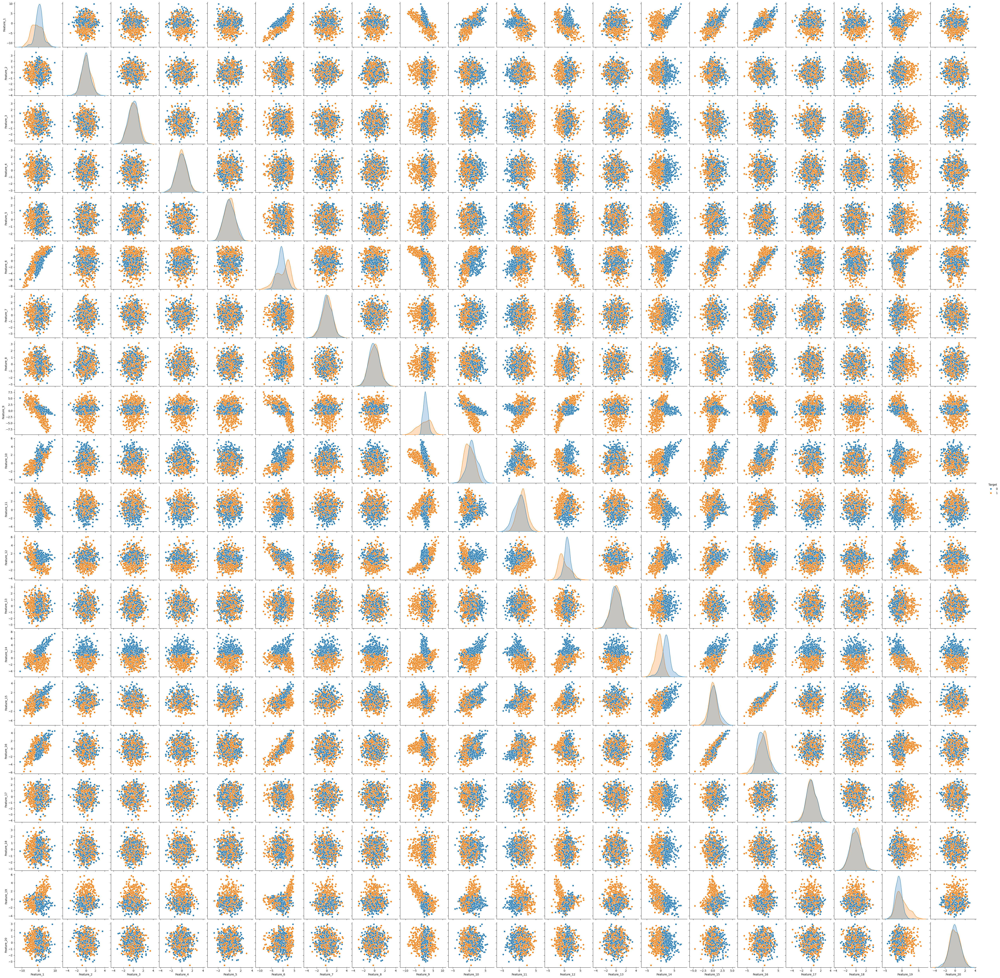

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Create a pairplot to visualize pairwise relationships between features in the dataset.
# The 'hue' parameter is set to 'Target', so points are colored based on their class (0 or 1).
sns.pairplot(dataset, hue='Target')

plt.show()

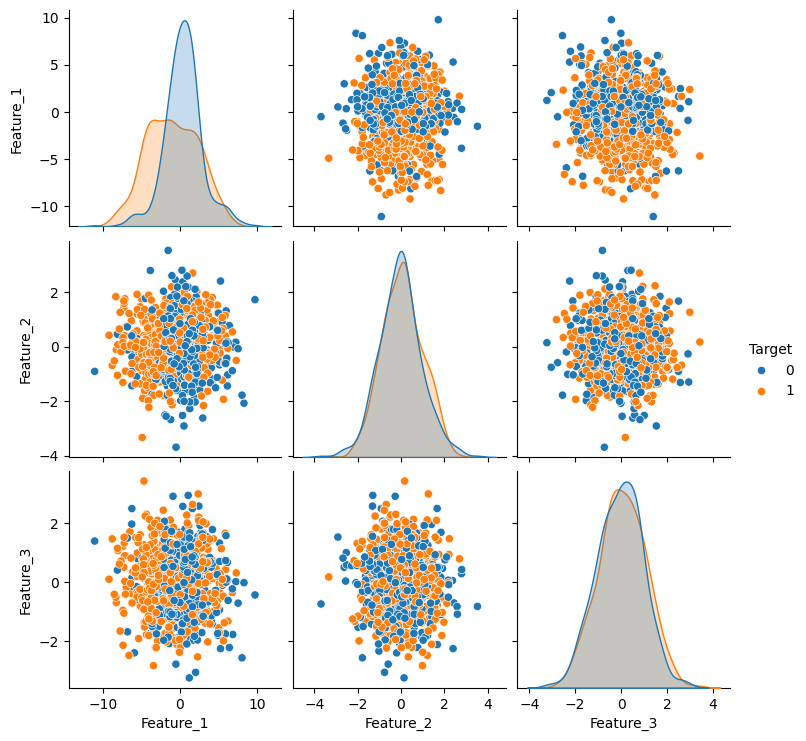

In [ ]:
subset_features = ['Feature_1', 'Feature_2', 'Feature_3', 'Target']
sns.pairplot(dataset[subset_features], hue='Target')
plt.show()

Epoch 0: Cost 0.6931471805599435
Epoch 100: Cost 0.4721630165988162
Epoch 200: Cost 0.45113539258690866
Epoch 300: Cost 0.4454459341230424
Epoch 400: Cost 0.4431080485519838
Epoch 500: Cost 0.4418602847518629
Epoch 600: Cost 0.4410769019935126
Epoch 700: Cost 0.44053789436945856
Epoch 800: Cost 0.440148535849892
Epoch 900: Cost 0.4398599284333773
Accuracy without regularization: 0.8000
Epoch 0: Cost 0.6931471805599435
Epoch 100: Cost 0.5758661428490168
Epoch 200: Cost 0.559753290839859
Epoch 300: Cost 0.5511272235076476
Epoch 400: Cost 0.5444408433578095
Epoch 500: Cost 0.5417283460945987
Epoch 600: Cost 0.540991212082997
Epoch 700: Cost 0.5404239483285898
Epoch 800: Cost 0.5403859861455974
Epoch 900: Cost 0.540268370740759
Accuracy with L1 regularization: 0.7850
Epoch 0: Cost 0.6931471805599435
Epoch 100: Cost 0.4954753659642672
Epoch 200: Cost 0.48491944138762627
Epoch 300: Cost 0.4833883792901837
Epoch 400: Cost 0.4830226841464803
Epoch 500: Cost 0.48289616508674893
Epoch 600: Cost 

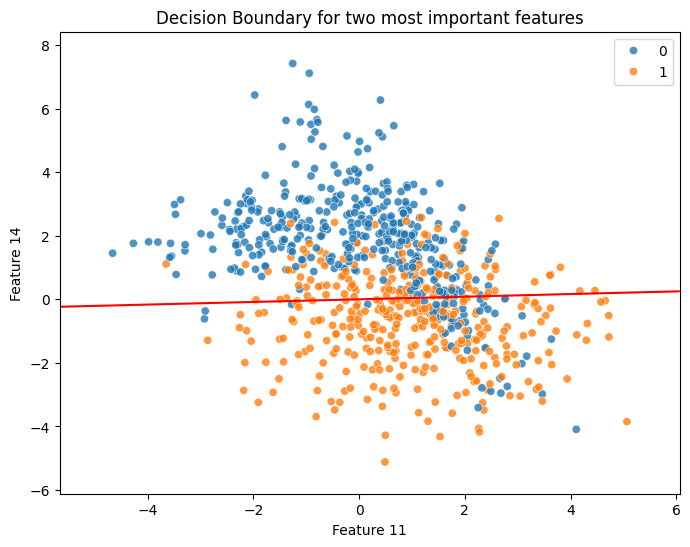

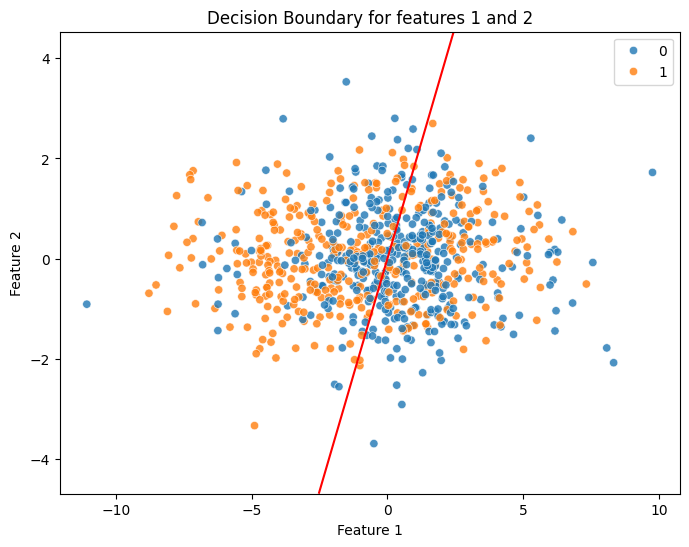

In [ ]:
import numpy as np
from sklearn.datasets import make_classification
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score
import matplotlib.pyplot as plt
import seaborn as sns

#Sigmoid function
def S(t):
    return 1 / (1 + np.exp(-t))

#Loglikelihood function with L1 and L2 regularization
def loglikehood(X, y, beta, l1_lambda=0, l2_lambda=0):
    #Calculates the loglikelihood for logistic regression
    n = X.shape[0]
    regularization_term = 0
    if l1_lambda > 0:
        #L1 regularization term
        regularization_term = l1_lambda * np.sum(np.abs(beta))
    if l2_lambda > 0:
        #L2 regularization term
        regularization_term = l2_lambda * np.sum(beta ** 2)

    return -np.mean(y * np.log(S(X @ beta) + 1e-15) + (1 - y) * np.log(1 - S(X @ beta) + 1e-15)) + regularization_term

#Gradient descent with L1 and L2 regularization
def gradient_descent(X, y, learning_rate, epochs, l1_lambda=0, l2_lambda=0):
    n = X.shape[0]
    beta = np.zeros(X.shape[1])
    cost_history = np.zeros(epochs)

    for epoch in range(epochs):
        t = X @ beta
        y_pred = S(t)

        cost = loglikehood(X, y, beta, l1_lambda, l2_lambda)
        cost_history[epoch] = cost

        dbeta = (1 / n) * X.T @ (y_pred - y)

        #Add regularization terms to the gradient
        if l1_lambda > 0:
            dbeta += l1_lambda * np.sign(beta)  #L1 regularization gradient
        if l2_lambda > 0:
            dbeta += 2 * l2_lambda * beta  # L2regularization gradient

        beta = beta - learning_rate * dbeta

        if epoch % 100 == 0:
            print(f"Epoch {epoch}: Cost {cost}")

    return beta, cost_history

#Logistic regression with L1/L2 regularization
def logistic_regression(X, y, learning_rate, epochs, l1_lambda=0, l2_lambda=0):
    beta, cost_history = gradient_descent(X, y, learning_rate, epochs, l1_lambda, l2_lambda)
    return beta, cost_history

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

#Without regularization
beta, cost_history = logistic_regression(X_train, y_train, learning_rate=0.01, epochs=1000)
y_pred = (S(X_test @ beta) > 0.5).astype(int)
accuracy = accuracy_score(y_test, y_pred)
print(f"Accuracy without regularization: {accuracy:.4f}")

#With L1 regularization
beta_l1, cost_history_l1 = logistic_regression(X_train, y_train, learning_rate=0.01, epochs=1000, l1_lambda=0.1)
y_pred_l1 = (S(X_test @ beta_l1) > 0.5).astype(int)
accuracy_l1 = accuracy_score(y_test, y_pred_l1)
print(f"Accuracy with L1 regularization: {accuracy_l1:.4f}")

#With L2 regularization
beta_l2, cost_history_l2 = logistic_regression(X_train, y_train, learning_rate=0.01, epochs=1000, l2_lambda=0.1)
y_pred_l2 = (S(X_test @ beta_l2) > 0.5).astype(int)
accuracy_l2 = accuracy_score(y_test, y_pred_l2)
print(f"Accuracy with L2 regularization: {accuracy_l2:.4f}")

# Wypisanie cech wybranych przez L1 regularizację
selected_features_l1 = np.where(np.abs(beta_l1) > 1e-4)[0]  # Cechy, których współczynniki są większe niż próg
print(f"Selected features (indices) by L1 regularization: {selected_features_l1}")

# Select two most important features based on the highest absolute values of beta_l1
top_features_idx = np.argsort(np.abs(beta_l1))[-2:]  # Indices of two most important features
top_features = top_features_idx  # Store the indices of top features

# Extract the data for the two most important features
X_train_selected = X_train[:, top_features]

# Print the selected features
print(f"Two most important features: {[f'Feature_{i+1}' for i in top_features]}")

#Plot decision boundary for the two selected features
plt.figure(figsize=(8, 6))
sns.scatterplot(x=X_train_selected[:, 0], y=X_train_selected[:, 1], hue=y_train, alpha=0.8)
plt.xlabel(f"Feature {top_features[0]+1}")
plt.ylabel(f"Feature {top_features[1]+1}")
plt.title("Decision Boundary for two most important features")

#Create grid for decision boundary
x_min, x_max = X_train_selected[:, 0].min() - 1, X_train_selected[:, 0].max() + 1
y_min, y_max = X_train_selected[:, 1].min() - 1, X_train_selected[:, 1].max() + 1
xx, yy = np.meshgrid(np.linspace(x_min, x_max, 200), np.linspace(y_min, y_max, 200))
grid = np.c_[xx.ravel(), yy.ravel()]

#Predict probabilities for the grid
grid_predictions = S(grid @ beta_l1[top_features])  # Corrected this line
zz = grid_predictions.reshape(xx.shape)

#Plot decision boundary
plt.contour(xx, yy, zz, levels=[0.5], colors='red')  # Decision boundary (P = 0.5)
plt.show()

#Plot decision boundary for features 1 and 2
plt.figure(figsize=(8, 6))
sns.scatterplot(x=X_train[:, 0], y=X_train[:, 1], hue=y_train, alpha=0.8)  # Use indices 0 and 1 directly
plt.xlabel(f"Feature 1")
plt.ylabel(f"Feature 2")
plt.title("Decision Boundary for features 1 and 2")

#Create grid for decision boundary
x_min, x_max = X_train[:, 0].min() - 1, X_train[:, 0].max() + 1
y_min, y_max = X_train[:, 1].min() - 1, X_train[:, 1].max() + 1
xx, yy = np.meshgrid(np.linspace(x_min, x_max, 200), np.linspace(y_min, y_max, 200))
grid = np.c_[xx.ravel(), yy.ravel()]

#Predict probabilities for the grid using beta_l1 for features 1 and 2
grid_predictions = S(grid @ beta_l1[[0, 1]])  # Use the coefficients for features 0 and 1
zz = grid_predictions.reshape(xx.shape)

#Plot decision boundary
plt.contour(xx, yy, zz, levels=[0.5], colors='red')  # Decision boundary (P = 0.5)
plt.show()


Absolute values of L1 coefficients:
[1.87881605e-03 1.01306243e-03 6.88783671e-04 2.03293114e-04
 6.41833424e-04 5.13654303e-04 1.84300532e-04 7.87284670e-04
 1.10551855e-03 2.66735555e-04 2.75202598e-02 3.23800467e-04
 4.48698874e-05 6.63717998e-01 5.04029367e-04 1.21454540e-03
 3.80899926e-04 6.54818302e-04 6.23313339e-04 1.02312172e-03]


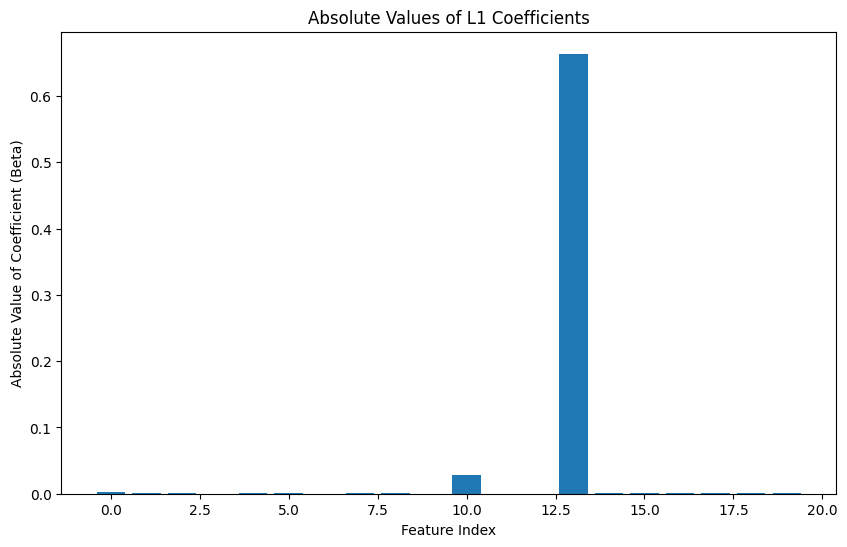

In [ ]:
#Print absolute values of beta_l1 coefficients
print("Absolute values of L1 coefficients:")
print(np.abs(beta_l1))

#Bar plot of absolute values of L1 coefficients
plt.figure(figsize=(10, 6))
plt.bar(range(len(beta_l1)), np.abs(beta_l1))
plt.title("Absolute Values of L1 Coefficients")
plt.xlabel("Feature Index")
plt.ylabel("Absolute Value of Coefficient (Beta)")
plt.show()